<a href="https://colab.research.google.com/github/junior0428/GEE/blob/main/01_EDGEE.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**MASTERGIS: Como inicializar la Earth Engine Python API**
En esta lectura, aprenderemos sobre como inicializar la Earth Engine Python API (oauth2).
###En Colap esta instalado GEE por defecto por ello solo se llama con **import ee**
###Si queremos instalar en nuestras maquina escribimos **!pip install earthengine-api**

In [ ]:
import ee 
ee.Initialize()

##**1) Inicializa la Earth Engine de Python**

In [ ]:
!earthengine authenticate

##**2) Autentifica la Earth Engine Python API como un experto!**

In [ ]:
!earthengine authenticate

In [ ]:
#Esto es una version antigua que elimino google 
auth_code = '4/1AX4XfWjRAK8zwaj1FmNf7Ne2rJNaYGowYUcQwkIkQT56wvCZ4nayXThJEMQ'
ee_token = ee.oauth.request_token(auth_code, oauth_code[0])

In [3]:

#@title mapdisplay: Crea mapas interactivos usando folium
import folium
def mapdisplay(center, dicc, Tiles="OpensTreetMap",zoom_start=10):
    '''
    :param center: Center of the map (Latitude and Longitude).
    :param dicc: Earth Engine Geometries or Tiles dictionary
    :param Tiles: Mapbox Bright,Mapbox Control Room,Stamen Terrain,Stamen Toner,stamenwatercolor,cartodbpositron.
    :zoom_start: Initial zoom level for the map.
    :return: A folium.Map object.
    '''
    center = center[::-1]
    mapViz = folium.Map(location=center,tiles=Tiles, zoom_start=zoom_start)
    for k,v in dicc.items():
      if ee.image.Image in [type(x) for x in v.values()]:
        folium.TileLayer(
            tiles = v["tile_fetcher"].url_format,
            attr  = 'Google Earth Engine',
            overlay =True,
            name  = k
          ).add_to(mapViz)
      else:
        folium.GeoJson(
        data = v,
        name = k
          ).add_to(mapViz)
    mapViz.add_child(folium.LayerControl())
    return mapViz

Por actualizacion se utiliza ee.Authenticate()

In [ ]:
import ee
ee.Authenticate()
ee.Initialize()

In [ ]:
from pprint import pprint
srtm=ee.Image("NASA/NASADEM_HGT/001") 
pprint(srtm.getInfo())

In [ ]:
srtm=ee.Image("NASA/NASADEM_HGT/001") 
inferno_pal = ["#000004", "#560F6D", "#BB3654", "#F98C09", "#FCFFA4"]
srtm_id_01=srtm.getMapId()
srtm_id_02=srtm.getMapId({'bands': 'elevation', 'palette':inferno_pal, 'min': 0, 'max': 5500})
center=[0,0]
dicc_viz = {'simple_srtm':srtm_id_01,
            'complex_srtm': srtm_id_02
            }
mapdisplay(center, dicc_viz, zoom_start = 3)
      

In [ ]:
rain_peru = ee.Image('users/csaybardemo/P99')
nc_shp = ee.FeatureCollection('users/csaybardemo/nc_wgs84')

dicc_viz_02 = {'rain_peru_max': rain_peru.getMapId({'min':0,'max':200}),
               'nc_wgs84': nc_shp.getInfo()}
center = [-76,-12]
mapdisplay(center,dicc_viz_02,zoom_start=7)

#**Visualizacion de nuestros propios datos**

In [ ]:
#inicializamos ee
import ee
ee.Authenticate()
ee.Initialize()

To authorize access needed by Earth Engine, open the following URL in a web browser and follow the instructions. If the web browser does not start automatically, please manually browse the URL below.

    https://accounts.google.com/o/oauth2/auth?client_id=517222506229-vsmmajv00ul0bs7p89v5m89qs8eb9359.apps.googleusercontent.com&scope=https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fearthengine+https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdevstorage.full_control&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&response_type=code&code_challenge=khxk4t-JUVyKRt3gs02yhw_N8a8Aqiwh282gVYoUb_I&code_challenge_method=S256

The authorization workflow will generate a code, which you should paste in the box below. 
Enter verification code: 4/1AX4XfWgpxQF1Lgo3JTuZVck9fD46rMIMl5847b0UA7jYUbkZtU6jiQfMJ30

Successfully saved authorization token.


In [ ]:
cara_image=ee.Image('users/mastergis01/Planet_carabayllo')
cara_image.min(['b1'])

In [ ]:
#visualizamos datos del asset

cara_image=ee.Image('users/mastergis01/Planet_carabayllo')
ban=['b1','b2', 'b3']
dicc_viz_02={'carabayllo_planet':cara_image.getMapId({'bands':ban, 'min':3718, 'max':9070})}
center=[-76, -12]
mapdisplay(center,dicc_viz_02, zoom_start=7)


In [ ]:

cuenca_peru=ee.FeatureCollection('users/juniorantoniocalvomontanez/shape_amazon')
centr_shp=cuenca_peru.geometry().centroid().coordinates().getInfo()
dicc_viz_02={'Hidrografica':cuenca_peru.getInfo()}

mapdisplay(centr_shp,dicc_viz_02)

In [ ]:
cuenca_peru

In [ ]:
# Load an image.
image = ee.Image('LANDSAT/LC08/C01/T1_TOA/LC08_044034_20140318')

# Create an NDWI image, define visualization parameters and display.
ndwi = image.normalizedDifference(['B3', 'B5'])
ndwi_viz = {'min': 0.5, 'max': 1, 'palette': ['00FFFF', '0000FF']}

# Define a map centered on San Francisco Bay.
map_ndwi = folium.Map(location=[37.5010, -122.1899], zoom_start=10)

# Add the image layer to the map and display it.
map_ndwi.add_ee_layer(ndwi, ndwi_viz, 'NDWI')
#display(map_ndwi)

###**Crear un diagrama de dispersión**
**matplotlib.pyplot**: Esta es una libreria para realizar gráficos estaticos

In [4]:
import matplotlib.pyplot as plt

#Cargar una imagen Landsat
img = ee.Image('LANDSAT/LC08/C01/T1_TOA/LC08_044034_20140318')
centroid = img.geometry().centroid().getInfo()['coordinates']

#Generar un  mapa con folium :)
mydicc = {'landsat5': img.getMapId({'min':0,'max':0.5,'bands':['B5','B4','B3']})}

mapdisplay(centroid, mydicc, Tiles="OpensTreetMap",zoom_start=9)

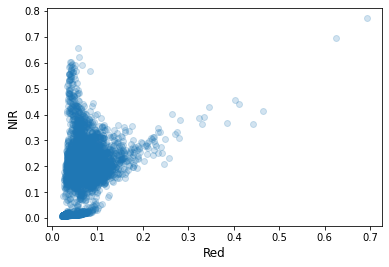

In [16]:
from pprint import pprint
# Seleccione las bandas rojas y NIR, escalelas y muestree 500 puntos.
samp_fc = img.select(['B4','B5']).sample(scale=30, numPixels=5000)
#pprint(samp_fc.getInfo())

# Organice la muestra como una lista de listas.
samp_dict = samp_fc.reduceColumns(ee.Reducer.toList().repeat(2), ['B4', 'B5'])
ee.Reducer.toList().repeat(2).getInfo()
samp_list = ee.List(samp_dict.get('list'))

# Guardar ee.List del lado del servidor como una lista de Python del lado del cliente.
samp_data = samp_list.getInfo()

# Visualice un diagrama de dispersion Red vs NIR usando matplotlib.
plt.scatter(samp_data[0], samp_data[1], alpha=0.2)
plt.xlabel('Red', fontsize=12)
plt.ylabel('NIR', fontsize=12)
plt.show()